<a href="https://colab.research.google.com/github/aparnashenoy/ml/blob/master/smote_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip 

     / 56.5MB 74.2MB/s
     |████████████████████████████████| 81kB 3.8MB/s 
     |████████████████████████████████| 604kB 11.3MB/s 
     |████████████████████████████████| 3.1MB 16.2MB/s 
     |████████████████████████████████| 71kB 8.0MB/s 
     |████████████████████████████████| 296kB 34.5MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-2.10.0-py2.py3-none-any.whl size=232422 sha256=963ad155ae94a4b7a7575d8e8a42c126c96eeb76bc6daa9281e242dcc1509a68
  Stored in directory: /tmp/pip-ephem-wheel-cache-embv_kki/wheels/56/c2/dd/8d945b0443c35df7d5f62fa9e9ae105a2d8b286302b92e0109
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp36-none-any.whl size=27085 sha256=18e9ab99dbc71ac23bc7b87a5e93651131662c31e1c684e03947901958185a2f
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
Successfully built pandas-profiling htmlmin
  Found existing installation: tqdm 4.41.1
    Uninstalling tqdm-4.41.1:
      Successfully un

In [ ]:
from pandas_profiling import ProfileReport

In [1]:
from google.colab import drive
drive.mount('/gdrive')

Mounted at /gdrive


In [2]:
path = '/gdrive/My Drive/'

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [4]:
from matplotlib import rcParams
rcParams['figure.figsize'] = 20, 14

In [5]:
from matplotlib.cm import rainbow

In [6]:
df = pd.read_csv(path + 'data_cvs_resp.csv')

In [7]:
df.drop(['Unnamed: 0'], axis = 1, inplace= True)

In [8]:
cols=df.shape[1]
print("columns = {}".format(cols))

columns = 9


In [9]:
df.head()

,HR,O2Sat,SBP,MAP,DBP,Resp,Age,Gender,SepsisLabel
0,99.0,100.0,120.0,71.0,61.0,13.5,69.66,0,0
1,97.5,100.0,120.0,79.0,61.0,15.0,69.66,0,0
2,96.0,100.0,120.0,70.0,61.0,13.0,69.66,0,0
3,100.0,99.0,120.0,75.0,61.0,14.0,69.66,0,0
4,102.0,100.0,120.0,74.0,61.0,17.0,69.66,0,0


In [10]:
df.columns = map(str.lower, df.columns)
df.columns

Index(['hr', 'o2sat', 'sbp', 'map', 'dbp', 'resp', 'age', 'gender',
       'sepsislabel'],
      dtype='object')

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1167202 entries, 0 to 1167201
Data columns (total 9 columns):
 #   Column       Non-Null Count    Dtype  
---  ------       --------------    -----  
 0   hr           1167202 non-null  float64
 1   o2sat        1167202 non-null  float64
 2   sbp          1167202 non-null  float64
 3   map          1167202 non-null  float64
 4   dbp          1167202 non-null  float64
 5   resp         1167202 non-null  float64
 6   age          1167202 non-null  float64
 7   gender       1167202 non-null  int64  
 8   sepsislabel  1167202 non-null  int64  
dtypes: float64(7), int64(2)
memory usage: 80.1 MB


In [12]:
df['sepsislabel'] = df['sepsislabel'].astype('category')

In [13]:
df['gender']=df['gender'].astype('category')

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1167202 entries, 0 to 1167201
Data columns (total 9 columns):
 #   Column       Non-Null Count    Dtype   
---  ------       --------------    -----   
 0   hr           1167202 non-null  float64 
 1   o2sat        1167202 non-null  float64 
 2   sbp          1167202 non-null  float64 
 3   map          1167202 non-null  float64 
 4   dbp          1167202 non-null  float64 
 5   resp         1167202 non-null  float64 
 6   age          1167202 non-null  float64 
 7   gender       1167202 non-null  category
 8   sepsislabel  1167202 non-null  category
dtypes: category(2), float64(7)
memory usage: 64.6 MB


In [15]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
hr,1167202.0,84.213367,13.138542,64.0,74.0,84.00,94.00,106.0
o2sat,1167202.0,97.529540,1.965434,94.0,96.0,98.00,99.00,100.0
sbp,1167202.0,121.730389,16.610081,97.5,109.0,120.00,134.00,151.0
map,1167202.0,79.948555,10.731372,64.0,71.0,79.00,88.50,97.0
dbp,1167202.0,61.454623,6.991990,50.0,58.0,61.00,64.50,74.0
resp,1167202.0,18.451131,3.638062,13.0,16.0,18.00,21.00,25.0
age,1167202.0,62.333790,16.280111,14.0,52.0,64.08,74.96,100.0


In [21]:
df=df.sample(n=20000, random_state=1234, axis=None, weights=None)

In [22]:
df.sepsislabel.value_counts()

0    19612
1      388
Name: sepsislabel, dtype: int64

In [ ]:
profile = ProfileReport(df)

In [ ]:
profile

In [ ]:
profile.to_notebook_iframe()

In [ ]:
profile.to_file(output_file = path+ 'cvs_rr.html')

In [23]:
corr = df.corr()
corr

,hr,o2sat,sbp,map,dbp,resp,age
hr,1.000000,-0.073689,-0.030338,0.080877,0.115642,0.213861,-0.148077
o2sat,-0.073689,1.000000,0.010533,0.015726,0.001491,-0.158406,-0.041075
sbp,-0.030338,0.010533,1.000000,0.758075,0.456250,0.044261,0.020765
map,0.080877,0.015726,0.758075,1.000000,0.718562,0.038539,-0.141518
dbp,0.115642,0.001491,0.456250,0.718562,1.000000,0.030669,-0.220088
resp,0.213861,-0.158406,0.044261,0.038539,0.030669,1.000000,0.050173
age,-0.148077,-0.041075,0.020765,-0.141518,-0.220088,0.050173,1.000000


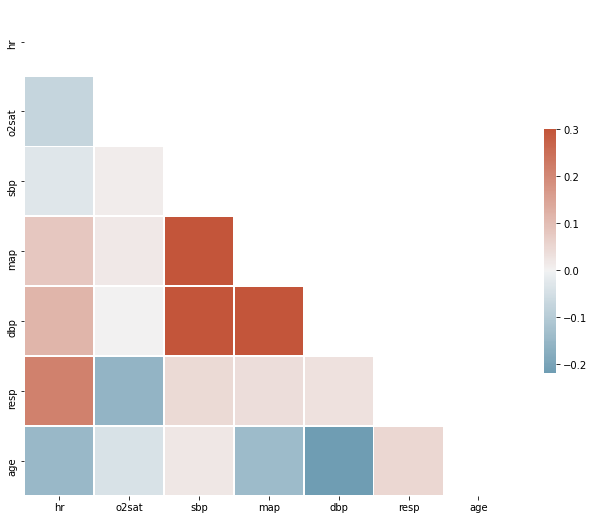

In [24]:
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [25]:
y = df.sepsislabel.values
x = df.drop(["sepsislabel", 'gender'], axis = 1)

In [26]:
x=(x-x.mean())/(x.max()-x.min())

In [27]:
x.head()

,hr,o2sat,sbp,map,dbp,resp,age
534239,-0.243433,0.079287,-0.455225,-0.485319,-0.479398,-0.040390,0.295451
918033,-0.005338,0.079287,-0.034664,-0.030773,-0.021065,-0.040390,-0.445621
154338,0.280377,0.079287,0.451317,0.029833,-0.479398,-0.123723,0.145689
832533,-0.005338,0.412621,0.544775,0.514681,0.520602,-0.040390,-0.243240
534696,-0.124385,-0.420713,-0.389805,-0.485319,-0.021065,-0.207056,-0.032168


In [28]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=42)

In [29]:
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((14000, 7), (6000, 7), (14000,), (6000,))

In [30]:
from sklearn.linear_model import LogisticRegression
model = LogisticRegression(max_iter=10000)

model.fit(x_train, y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=10000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [31]:
train_pred = model.predict(x_train)

test_pred = model.predict(x_test)

# Use score method to get accuracy of model
score = model.score(x_train, y_train)
print('Train F1 Score = {} %'.format(round(score,4)*100))

# Use score method to get accuracy of model
score = model.score(x_test, y_test)
print('Test F1 Score = {} %'.format(round(score,4)*100))

Train F1 Score = 98.05 %
Test F1 Score = 98.08 %


In [32]:
from sklearn.metrics import accuracy_score

train_accuracy = accuracy_score(y_train, train_pred)
train_accuracy = round(train_accuracy, 4)*100
print('Training Accuracy = {} %'.format(train_accuracy))

test_accuracy = accuracy_score(y_test, test_pred)
test_accuracy = round(test_accuracy, 4)*100
print('Test Accuracy = {} %'.format(test_accuracy))

Training Accuracy = 98.05 %
Test Accuracy = 98.08 %


[[5885    0]
 [ 115    0]]


Text(0.5, 1.0, 'Test F1 Score:98.08%')

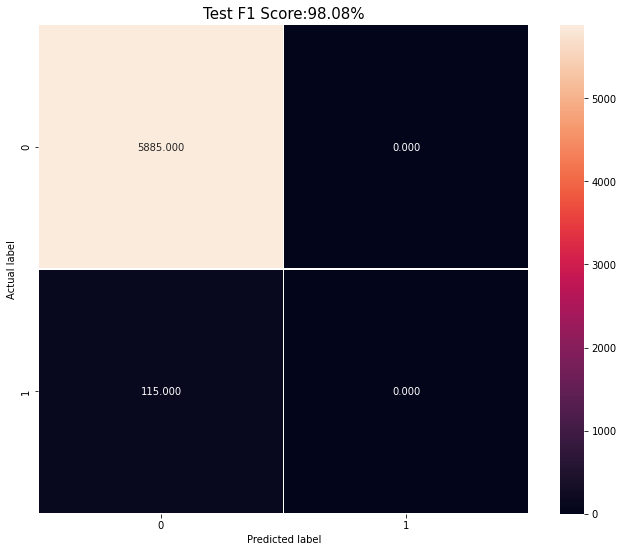

In [33]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

conf_matrix = confusion_matrix(y_test, test_pred)
print(conf_matrix)

plt.figure(figsize=(11,9))
sns.heatmap(conf_matrix, annot=True, fmt=".3f", linewidths=.5)

plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Test F1 Score:{}%'.format(round(score, 4)*100)
plt.title(all_sample_title, size = 15)

In [34]:
from sklearn.metrics import classification_report

print('*********************  Training Data Report  **********')
print(classification_report(y_train, train_pred))

print('***********************  Test Data Report  **********')
print(classification_report(y_test, test_pred))


*********************  Training Data Report  **********
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     13727
           1       0.00      0.00      0.00       273

    accuracy                           0.98     14000
   macro avg       0.49      0.50      0.50     14000
weighted avg       0.96      0.98      0.97     14000

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      5885
           1       0.00      0.00      0.00       115

    accuracy                           0.98      6000
   macro avg       0.49      0.50      0.50      6000
weighted avg       0.96      0.98      0.97      6000



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [35]:
print(test_pred)

[0 0 0 ... 0 0 0]


##smote technique

In [36]:
import imblearn

/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


In [37]:
from imblearn.over_sampling import SMOTE
smt = SMOTE()
x_train, y_train = smt.fit_sample(x_train, y_train)
np.bincount(y_train)

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


array([13727, 13727])

In [38]:
x_test, y_test = smt.fit_sample(x_test, y_test)
np.bincount(y_test)

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


array([5885, 5885])

In [39]:
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression()
logreg.fit(x_train, y_train)
y_pred = logreg.predict(x_test)
print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(logreg.score(x_test, y_test)))

Accuracy of logistic regression classifier on test set: 0.55


In [40]:
train_pred = logreg.predict(x_train)

test_pred = logreg.predict(x_test)

# Use score method to get accuracy of model
score = logreg.score(x_train, y_train)
print('Train F1 Score = {} %'.format(round(score,4)*100))

# Use score method to get accuracy of model
score = logreg.score(x_test, y_test)
print('Test F1 Score = {} %'.format(round(score,4)*100))

Train F1 Score = 58.63 %
Test F1 Score = 55.46 %


[[3614 2271]
 [2971 2914]]


Text(0.5, 1.0, 'Test F1 Score:55.46%')

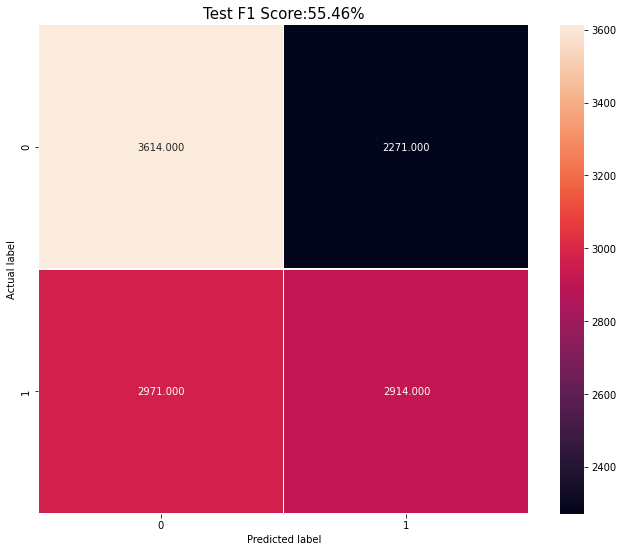

In [41]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

conf_matrix = confusion_matrix(y_test, test_pred)
print(conf_matrix)

plt.figure(figsize=(11,9))
sns.heatmap(conf_matrix, annot=True, fmt=".3f", linewidths=.5)

plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Test F1 Score:{}%'.format(round(score, 4)*100)
plt.title(all_sample_title, size = 15)

In [42]:
from sklearn.metrics import classification_report

print('*********************  Training Data Report  **********')
print(classification_report(y_train, train_pred))

print('***********************  Test Data Report  **********')
print(classification_report(y_test, test_pred))

*********************  Training Data Report  **********
              precision    recall  f1-score   support

           0       0.58      0.61      0.60     13727
           1       0.59      0.56      0.58     13727

    accuracy                           0.59     27454
   macro avg       0.59      0.59      0.59     27454
weighted avg       0.59      0.59      0.59     27454

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.55      0.61      0.58      5885
           1       0.56      0.50      0.53      5885

    accuracy                           0.55     11770
   macro avg       0.56      0.55      0.55     11770
weighted avg       0.56      0.55      0.55     11770



In [43]:
from sklearn.svm import SVC
classifier_rbf = SVC(kernel = 'rbf')
classifier_rbf.fit(x_train, y_train)
y_pred = classifier_rbf.predict(x_test)
print('Accuracy of SVC (RBF) classifier on test set: {:.2f}'.format(classifier_rbf.score(x_test, y_test)))

Accuracy of SVC (RBF) classifier on test set: 0.58


In [44]:
train_pred = classifier_rbf.predict(x_train)

test_pred = classifier_rbf.predict(x_test)

# Use score method to get accuracy of model
score = classifier_rbf.score(x_train, y_train)
print('Train F1 Score = {} %'.format(round(score,4)*100))

# Use score method to get accuracy of model
score = classifier_rbf.score(x_test, y_test)
print('Test F1 Score = {} %'.format(round(score,4)*100))

Train F1 Score = 80.44 %
Test F1 Score = 58.15 %


[[4060 1825]
 [3101 2784]]


Text(0.5, 1.0, 'Test F1 Score:58.15%')

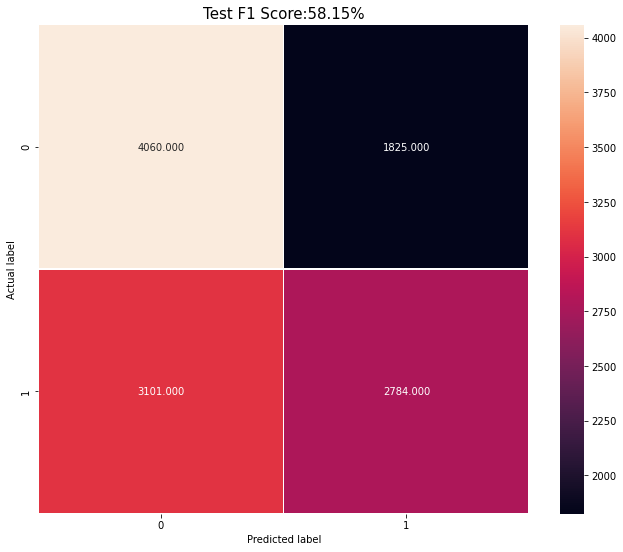

In [45]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

conf_matrix = confusion_matrix(y_test, test_pred)
print(conf_matrix)

plt.figure(figsize=(11,9))
sns.heatmap(conf_matrix, annot=True, fmt=".3f", linewidths=.5)

plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Test F1 Score:{}%'.format(round(score, 4)*100)
plt.title(all_sample_title, size = 15)

In [46]:
from sklearn.metrics import classification_report

print('*********************  Training Data Report  **********')
print(classification_report(y_train, train_pred))

print('***********************  Test Data Report  **********')
print(classification_report(y_test, test_pred))

*********************  Training Data Report  **********
              precision    recall  f1-score   support

           0       0.89      0.70      0.78     13727
           1       0.75      0.91      0.82     13727

    accuracy                           0.80     27454
   macro avg       0.82      0.80      0.80     27454
weighted avg       0.82      0.80      0.80     27454

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.57      0.69      0.62      5885
           1       0.60      0.47      0.53      5885

    accuracy                           0.58     11770
   macro avg       0.59      0.58      0.58     11770
weighted avg       0.59      0.58      0.58     11770



In [47]:
svc_scores = []
kernels = ['linear', 'poly', 'rbf', 'sigmoid']
for i in range(len(kernels)):
    svc_classifier = SVC(kernel = kernels[i])
    svc_classifier.fit(x_train, y_train)
    svc_scores.append(svc_classifier.score(x_test, y_test))

Text(0.5, 1.0, 'Support Vector Classifier scores for different kernels')

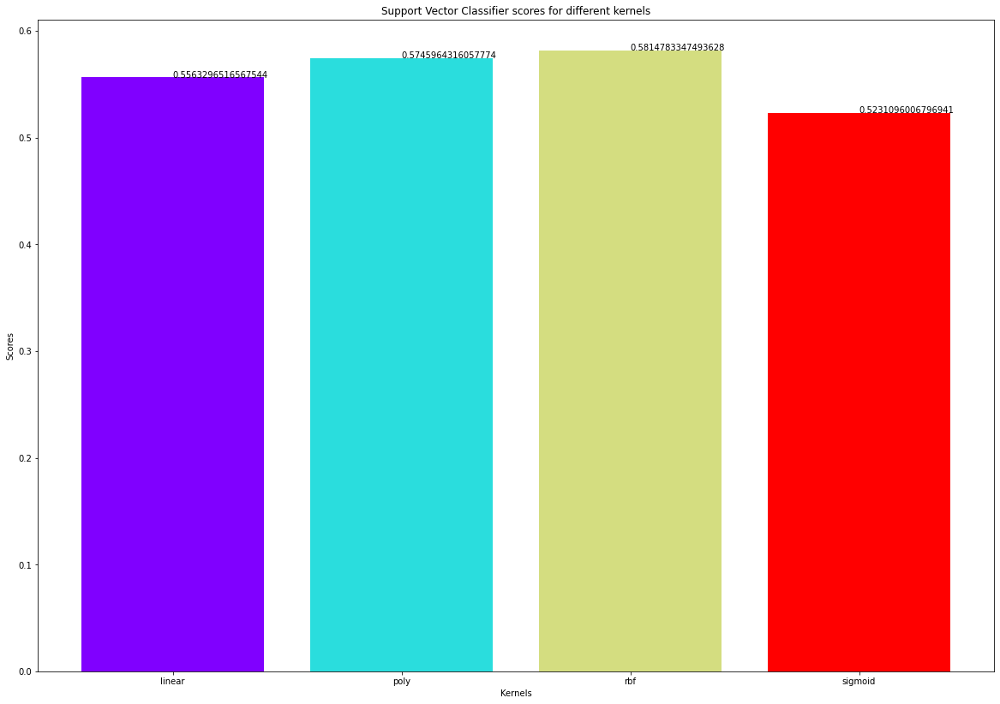

In [48]:
rcParams['figure.figsize'] = 20, 14
colors = rainbow(np.linspace(0, 1, len(kernels)))
plt.bar(kernels, svc_scores, color = colors)
for i in range(len(kernels)):
    plt.text(i, svc_scores[i], svc_scores[i])
plt.xlabel('Kernels')
plt.ylabel('Scores')
plt.title('Support Vector Classifier scores for different kernels')

In [49]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=300, bootstrap = True, max_features = 'sqrt')
rfc.fit(x_train, y_train)
y_pred = rfc.predict(x_test)
print('Accuracy of Random Forest on test set: {:.2f}'.format(rfc.score(x_test, y_test)))

Accuracy of Random Forest on test set: 0.64


In [50]:
train_pred = rfc.predict(x_train)

test_pred = rfc.predict(x_test)

# Use score method to get accuracy of model
score = rfc.score(x_train, y_train)
print('Train F1 Score = {} %'.format(round(score,4)*100))

# Use score method to get accuracy of model
score = rfc.score(x_test, y_test)
print('Test F1 Score = {} %'.format(round(score,4)*100))

Train F1 Score = 99.92 %
Test F1 Score = 64.25999999999999 %


[[5726  159]
 [4048 1837]]


Text(0.5, 1.0, 'Test F1 Score:64.25999999999999%')

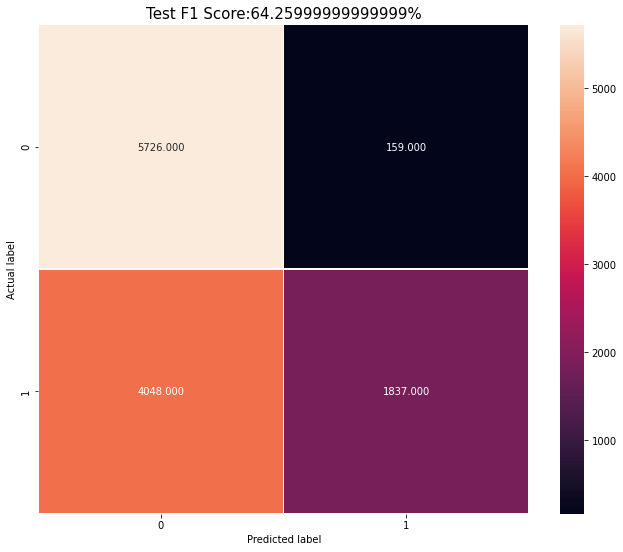

In [51]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

conf_matrix = confusion_matrix(y_test, test_pred)
print(conf_matrix)

plt.figure(figsize=(11,9))
sns.heatmap(conf_matrix, annot=True, fmt=".3f", linewidths=.5)

plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Test F1 Score:{}%'.format(round(score, 4)*100)
plt.title(all_sample_title, size = 15)

In [52]:
from sklearn.metrics import classification_report

print('*********************  Training Data Report  **********')
print(classification_report(y_train, train_pred))

print('***********************  Test Data Report  **********')
print(classification_report(y_test, test_pred))

*********************  Training Data Report  **********
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     13727
           1       1.00      1.00      1.00     13727

    accuracy                           1.00     27454
   macro avg       1.00      1.00      1.00     27454
weighted avg       1.00      1.00      1.00     27454

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.59      0.97      0.73      5885
           1       0.92      0.31      0.47      5885

    accuracy                           0.64     11770
   macro avg       0.75      0.64      0.60     11770
weighted avg       0.75      0.64      0.60     11770



In [53]:
rf_scores = []
estimators = [10, 100, 200, 500, 1000]
for i in estimators:
    rf_classifier = RandomForestClassifier(n_estimators = i, random_state = 0)
    rf_classifier.fit(x_train, y_train)
    rf_scores.append(rf_classifier.score(x_test, y_test))

Text(0.5, 1.0, 'Random Forest Classifier scores for different number of estimators')

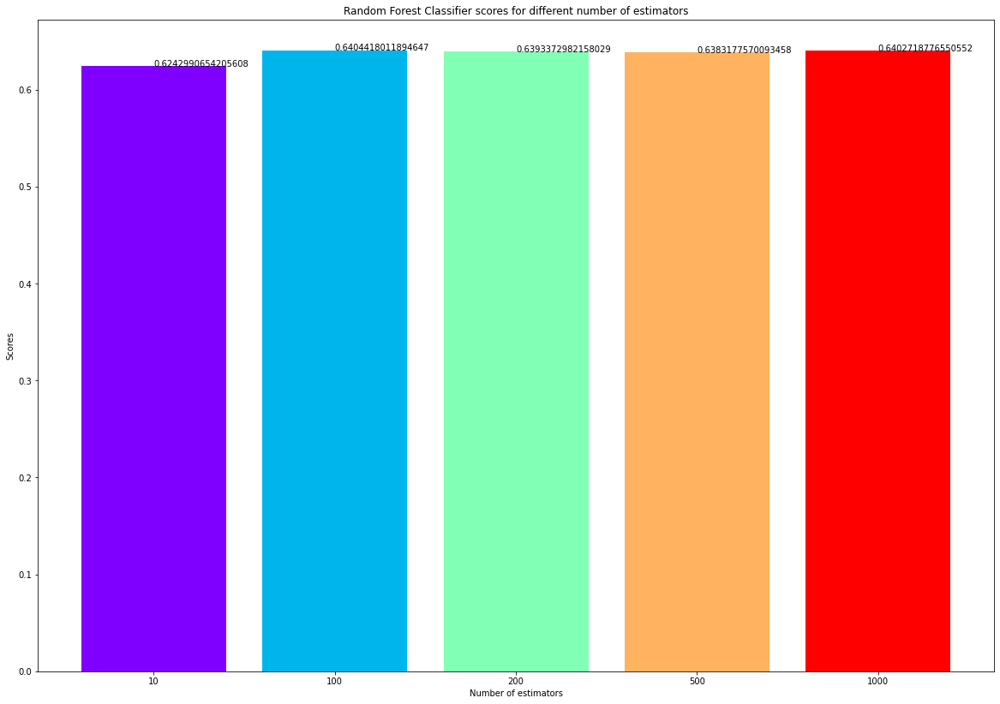

In [54]:
rcParams['figure.figsize'] = 20, 14
colors = rainbow(np.linspace(0, 1, len(estimators)))
plt.bar([i for i in range(len(estimators))], rf_scores, color = colors, width = 0.8)
for i in range(len(estimators)):
    plt.text(i, rf_scores[i], rf_scores[i])
plt.xticks(ticks = [i for i in range(len(estimators))], labels = [str(estimator) for estimator in estimators])
plt.xlabel('Number of estimators')
plt.ylabel('Scores')
plt.title('Random Forest Classifier scores for different number of estimators')

In [55]:
from sklearn.tree import DecisionTreeClassifier

In [56]:
dt_scores = []
for i in range(1, len(x.columns) + 1):
    dt_classifier = DecisionTreeClassifier(max_features = i, random_state = 0)
    dt_classifier.fit(x_train, y_train)
    dt_scores.append(dt_classifier.score(x_test, y_test))

Text(0.5, 1.0, 'Decision Tree Classifier scores for different number of maximum features')

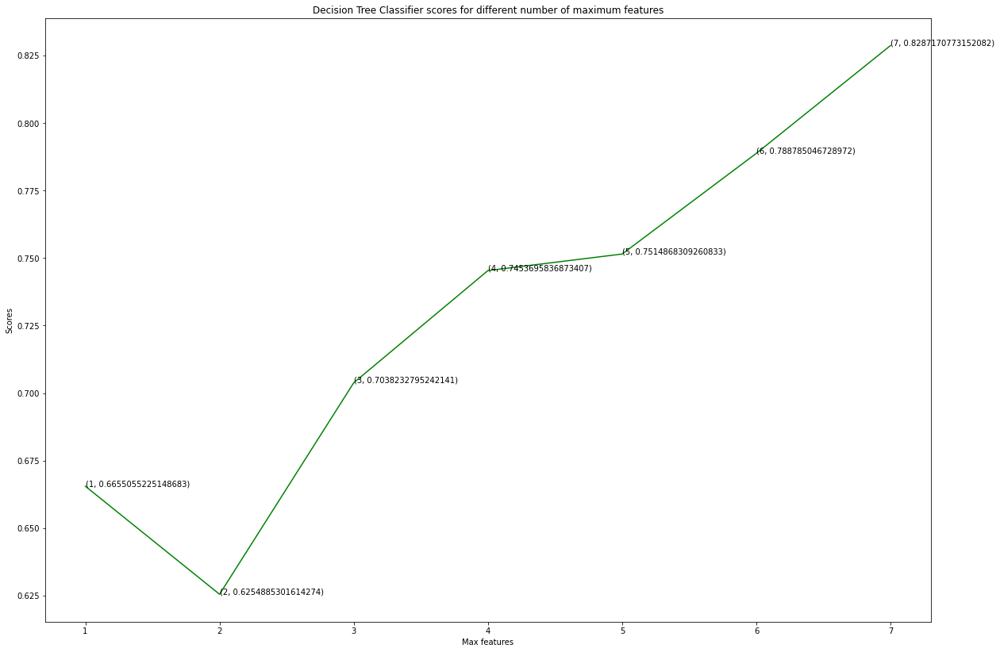

In [57]:
rcParams['figure.figsize'] = 20, 14
plt.plot([i for i in range(1, len(x.columns) + 1)], dt_scores, color = 'green')
for i in range(1, len(x.columns) + 1):
    plt.text(i, dt_scores[i-1], (i, dt_scores[i-1]))
plt.xticks([i for i in range(1, len(x.columns) + 1)])
plt.xlabel('Max features')
plt.ylabel('Scores')
plt.title('Decision Tree Classifier scores for different number of maximum features')

In [58]:
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO 
from IPython.display import Image 
from pydot import graph_from_dot_data

In [59]:
feature_columns = x.columns

In [60]:
feature_columns

Index(['hr', 'o2sat', 'sbp', 'map', 'dbp', 'resp', 'age'], dtype='object')

In [61]:
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
rcParams['figure.figsize'] = 20, 14
dot_data = StringIO()
export_graphviz(dt_classifier, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names = feature_columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png(path+'sepsis.png')
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.486035 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.486035 to fit



In [62]:
from sklearn import tree

In [63]:
text_representation = tree.export_text(dt_classifier)
print(text_representation)

|--- feature_5 <= -0.04
|   |--- feature_5 <= -0.46
|   |   |--- feature_3 <= 0.49
|   |   |   |--- feature_4 <= -0.36
|   |   |   |   |--- feature_0 <= 0.28
|   |   |   |   |   |--- feature_4 <= -0.48
|   |   |   |   |   |   |--- feature_0 <= 0.27
|   |   |   |   |   |   |   |--- feature_3 <= -0.00
|   |   |   |   |   |   |   |   |--- feature_3 <= -0.41
|   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |   |--- feature_3 >  -0.41
|   |   |   |   |   |   |   |   |   |--- feature_3 <= -0.39
|   |   |   |   |   |   |   |   |   |   |--- feature_1 <= 0.33
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 2
|   |   |   |   |   |   |   |   |   |   |--- feature_1 >  0.33
|   |   |   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |   |   |--- feature_3 >  -0.39
|   |   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |--- feature_3 >  -0.00
|   |   |   |   |   |   |   |   |--- feature_3 <= 

In [64]:
train_pred = dt_classifier.predict(x_train)

test_pred = dt_classifier.predict(x_test)

# Use score method to get accuracy of model
score = dt_classifier.score(x_train, y_train)
print('Train F1 Score = {} %'.format(round(score,4)*100))

# Use score method to get accuracy of model
score = dt_classifier.score(x_test, y_test)
print('Test F1 Score = {} %'.format(round(score,4)*100))

Train F1 Score = 99.92 %
Test F1 Score = 82.87 %


[[5539  346]
 [1670 4215]]


Text(0.5, 1.0, 'Test F1 Score:82.87%')

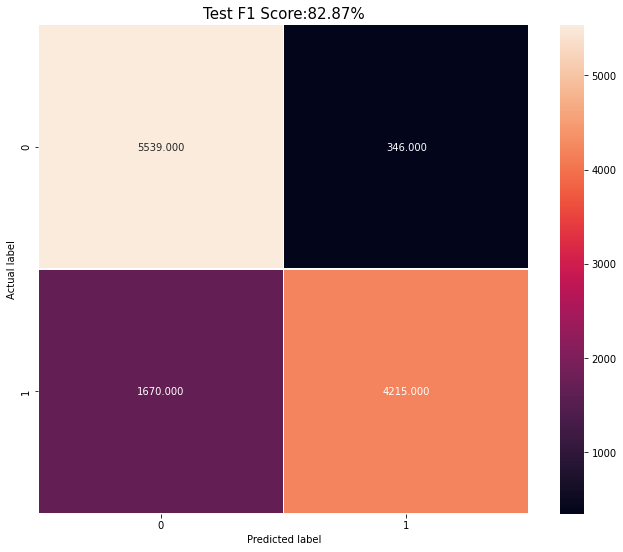

In [65]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

conf_matrix = confusion_matrix(y_test, test_pred)
print(conf_matrix)

plt.figure(figsize=(11,9))
sns.heatmap(conf_matrix, annot=True, fmt=".3f", linewidths=.5)

plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Test F1 Score:{}%'.format(round(score, 4)*100)
plt.title(all_sample_title, size = 15)

In [66]:
from sklearn.metrics import classification_report

print('*********************  Training Data Report  **********')
print(classification_report(y_train, train_pred))

print('***********************  Test Data Report  **********')
print(classification_report(y_test, test_pred))

*********************  Training Data Report  **********
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     13727
           1       1.00      1.00      1.00     13727

    accuracy                           1.00     27454
   macro avg       1.00      1.00      1.00     27454
weighted avg       1.00      1.00      1.00     27454

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.77      0.94      0.85      5885
           1       0.92      0.72      0.81      5885

    accuracy                           0.83     11770
   macro avg       0.85      0.83      0.83     11770
weighted avg       0.85      0.83      0.83     11770



In [67]:
pred_prob1 = logreg.predict_proba(x_test)

##SVC - caliberated classifier

In [68]:
from sklearn.calibration import CalibratedClassifierCV
from sklearn.svm import SVC, LinearSVC
classifier_rbf = LinearSVC()
classifier_rbf = CalibratedClassifierCV(classifier_rbf) 
classifier_rbf.fit(x_train, y_train)
pred_prob2 = classifier_rbf.predict_proba(x_test)

In [69]:
train_pred = classifier_rbf.predict(x_train)

test_pred = classifier_rbf.predict(x_test)

# Use score method to get accuracy of model
score = classifier_rbf.score(x_train, y_train)
print('Train F1 Score = {} %'.format(round(score,4)*100))

# Use score method to get accuracy of model
score = classifier_rbf.score(x_test, y_test)
print('Test F1 Score = {} %'.format(round(score,4)*100))

Train F1 Score = 58.620000000000005 %
Test F1 Score = 55.510000000000005 %


[[3616 2269]
 [2967 2918]]


Text(0.5, 1.0, 'Test F1 Score:55.510000000000005%')

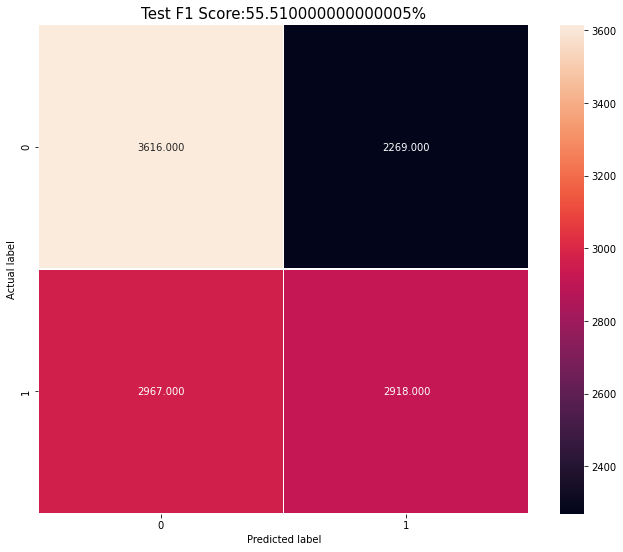

In [70]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

conf_matrix = confusion_matrix(y_test, test_pred)
print(conf_matrix)

plt.figure(figsize=(11,9))
sns.heatmap(conf_matrix, annot=True, fmt=".3f", linewidths=.5)

plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Test F1 Score:{}%'.format(round(score, 4)*100)
plt.title(all_sample_title, size = 15)

In [71]:
from sklearn.metrics import classification_report

print('*********************  Training Data Report  **********')
print(classification_report(y_train, train_pred))

print('***********************  Test Data Report  **********')
print(classification_report(y_test, test_pred))

*********************  Training Data Report  **********
              precision    recall  f1-score   support

           0       0.58      0.61      0.60     13727
           1       0.59      0.56      0.58     13727

    accuracy                           0.59     27454
   macro avg       0.59      0.59      0.59     27454
weighted avg       0.59      0.59      0.59     27454

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.55      0.61      0.58      5885
           1       0.56      0.50      0.53      5885

    accuracy                           0.56     11770
   macro avg       0.56      0.56      0.55     11770
weighted avg       0.56      0.56      0.55     11770



In [72]:
pred_prob3 = rfc.predict_proba(x_test)

In [73]:
pred_prob4 = dt_classifier.predict_proba(x_test)

##XGboost

In [74]:
! pip install xgboost

In [75]:
! pip install --upgrade xgboost

     |████████████████████████████████| 157.5MB 92kB/s 
  Found existing installation: xgboost 0.90
    Uninstalling xgboost-0.90:
      Successfully uninstalled xgboost-0.90


In [76]:
import xgboost as xgb

xgb_model = xgb.XGBClassifier(objective="binary:logistic", random_state=42)
xgb_model.fit(x_train, y_train)

print(xgb_model)

/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[13:02:56] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=2, num_parallel_tree=1,
              objective='binary:logistic', random_state=42, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', use_label_encoder=True,
              validate_parameters=1, verbosity=None)


In [78]:
# make predictions for test data
test_pred = xgb_model.predict(x_test)
predictions = [round(value) for value in test_pred]

In [79]:
# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

Accuracy: 90.64%


In [82]:
pred_prob5 = xgb_model.predict_proba(x_test)

In [83]:
from sklearn.metrics import roc_curve

# roc curve for models
fpr1, tpr1, thresh1 = roc_curve(y_test, pred_prob1[:,1], pos_label=1)
fpr2, tpr2, thresh2 = roc_curve(y_test, pred_prob2[:,1], pos_label=1)
fpr3, tpr3, thresh3 = roc_curve(y_test, pred_prob3[:,1], pos_label=1)
fpr4, tpr4, thresh4 = roc_curve(y_test, pred_prob4[:,1], pos_label=1)
fpr5, tpr5, thresh5 = roc_curve(y_test, pred_prob5[:,1], pos_label=1)
# roc curve for tpr = fpr 
random_probs = [0 for i in range(len(y_test))]
p_fpr, p_tpr, _ = roc_curve(y_test, random_probs, pos_label=1)

In [85]:
from sklearn.metrics import roc_auc_score

# auc scores
auc_score1 = roc_auc_score(y_test, pred_prob1[:,1])
auc_score2 = roc_auc_score(y_test, pred_prob2[:,1])
auc_score3 = roc_auc_score(y_test, pred_prob3[:,1])
auc_score4 = roc_auc_score(y_test, pred_prob4[:,1])
auc_score5 = roc_auc_score(y_test, pred_prob5[:,1])
print(auc_score1, auc_score2, auc_score3, auc_score4, auc_score5)

0.5784087823181352 0.5784465495200057 0.8858333002485331 0.83159889094937 0.9667471337133635


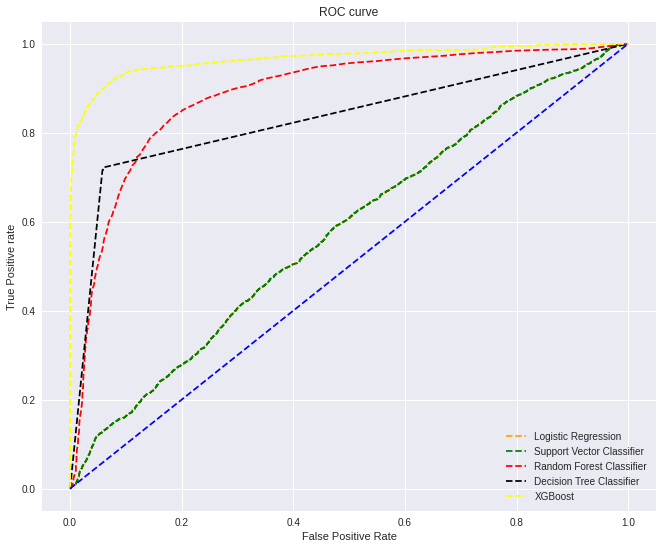

In [89]:
# matplotlib
import matplotlib.pyplot as plt
plt.style.use('seaborn')
plt.figure(figsize=(11,9))
# plot roc curves
plt.plot(fpr1, tpr1, linestyle='--',color='orange', label='Logistic Regression')
plt.plot(fpr2, tpr2, linestyle='--',color='green', label='Support Vector Classifier')
plt.plot(fpr3, tpr3, linestyle='--',color='red', label='Random Forest Classifier')
plt.plot(fpr4, tpr4, linestyle='--',color='black', label='Decision Tree Classifier')
plt.plot(fpr5, tpr5, linestyle='--',color='yellow', label='XGBoost')
plt.plot(p_fpr, p_tpr, linestyle='--', color='blue')
# title
plt.title('ROC curve')
# x label
plt.xlabel('False Positive Rate')
# y label
plt.ylabel('True Positive rate')

plt.legend(loc='best')
plt.savefig('ROC',dpi=300)
plt.show();

In [90]:
from sklearn.metrics import accuracy_score
from sklearn.feature_selection import SelectFromModel
from numpy import sort
from xgboost import XGBClassifier

In [91]:
# Fit model using each importance as a threshold
thresholds = sort(xgb_model.feature_importances_)
for thresh in thresholds:
	# select features using threshold
	selection = SelectFromModel(xgb_model, threshold=thresh, prefit=True)
	select_x_train = selection.transform(x_train)
	# train model
	selection_model = XGBClassifier()
	selection_model.fit(select_x_train, y_train)
	# eval model
	select_x_test = selection.transform(x_test)
	predictions = selection_model.predict(select_x_test)
	accuracy = accuracy_score(y_test, predictions)
	print("Thresh=%.3f, n=%d, Accuracy: %.2f%%" % (thresh, select_x_train.shape[1], accuracy*100.0))

/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[13:24:03] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Thresh=0.058, n=7, Accuracy: 90.64%
[13:24:06] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Thresh=0.074, n=6, Accuracy: 91.01%
[13:24:09] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Thresh=0.085, n=5, Accuracy: 90.60%
[13:24:11] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Thresh=0.103, n=4, Accuracy: 92.18%
[13:24:12] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Thresh=0.151, n=3, Accuracy: 92.68%
[13:24:14] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Thresh=0.251, n=2, Accuracy: 91.98%
[13:24:15] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Thresh=0.278, n=1, Accuracy: 85.09%


In [92]:
#Train the XGboost Model for Classification
model1 = xgb.XGBClassifier()
model2 = xgb.XGBClassifier(n_estimators=100, max_depth=8, learning_rate=0.1, subsample=0.5)

train_model1 = model1.fit(x_train, y_train)
train_model2 = model2.fit(x_train, y_train)

[13:24:16] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[13:24:19] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [94]:
#prediction and Classification Report
from sklearn.metrics import classification_report

pred1 = train_model1.predict(x_test)
pred2 = train_model2.predict(x_test)

print('Model 1 XGboost Report %r' % (classification_report(y_test, pred1)))
print('Model 2 XGboost Report %r' % (classification_report(y_test, pred2)))

Model 1 XGboost Report '              precision    recall  f1-score   support\n\n           0       0.86      0.98      0.91      5885\n           1       0.97      0.84      0.90      5885\n\n    accuracy                           0.91     11770\n   macro avg       0.91      0.91      0.91     11770\nweighted avg       0.91      0.91      0.91     11770\n'
Model 2 XGboost Report '              precision    recall  f1-score   support\n\n           0       0.81      0.97      0.88      5885\n           1       0.97      0.77      0.86      5885\n\n    accuracy                           0.87     11770\n   macro avg       0.89      0.87      0.87     11770\nweighted avg       0.89      0.87      0.87     11770\n'


In [95]:
from sklearn.metrics import classification_report

print('*********************  Training Data Report  **********')
print(classification_report(y_test, pred1))

print('***********************  Test Data Report  **********')
print(classification_report(y_test, pred2))

*********************  Training Data Report  **********
              precision    recall  f1-score   support

           0       0.86      0.98      0.91      5885
           1       0.97      0.84      0.90      5885

    accuracy                           0.91     11770
   macro avg       0.91      0.91      0.91     11770
weighted avg       0.91      0.91      0.91     11770

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.81      0.97      0.88      5885
           1       0.97      0.77      0.86      5885

    accuracy                           0.87     11770
   macro avg       0.89      0.87      0.87     11770
weighted avg       0.89      0.87      0.87     11770



In [96]:
#Let's use accuracy score
from sklearn.metrics import accuracy_score

print("Accuracy for model 1: %.2f" % (accuracy_score(y_test, pred1) * 100))
print("Accuracy for model 2: %.2f" % (accuracy_score(y_test, pred2) * 100))

Accuracy for model 1: 90.64
Accuracy for model 2: 87.14


In [97]:
#Let's do a little Gridsearch, Hyperparameter Tunning
model3 = xgb.XGBClassifier(
 learning_rate =0.1,
 n_estimators=1000,
 max_depth=5,
 min_child_weight=1,
 gamma=0,
 subsample=0.8,
 colsample_bytree=0.8,
 objective= 'binary:logistic',
 nthread=4,
 scale_pos_weight=1,
 seed=27)

In [99]:
train_model3 = model3.fit(x_train, y_train)
pred3 = train_model3.predict(x_test)
print("Accuracy for model 3: %.2f" % (accuracy_score(y_test, pred3) * 100))

/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[13:25:46] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy for model 3: 91.67


In [101]:
from sklearn.model_selection import GridSearchCV

param_test = {
 'max_depth':[4,5,6],
 'min_child_weight':[4,5,6]
}
gsearch = GridSearchCV(estimator = xgb.XGBClassifier( learning_rate=0.1, n_estimators=140, max_depth=5,
 min_child_weight=2, gamma=0, subsample=0.8, colsample_bytree=0.8,
 objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27), 
 param_grid = param_test, scoring='roc_auc',n_jobs=4,iid=False, cv=5)

train_model4 = gsearch.fit(x_train, y_train)
pred4 = train_model4.predict(x_test)
print("Accuracy for model 4: %.2f" % (accuracy_score(y_test, pred4) * 100))

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_search.py:823: FutureWarning: The parameter 'iid' is deprecated in 0.22 and will be removed in 0.24.
  "removed in 0.24.", FutureWarning
/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[13:29:34] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy for model 4: 90.39


In [102]:
param_test2b = {
 'min_child_weight':[6,8,10,12]
}
gsearch2b = GridSearchCV(estimator = xgb.XGBClassifier( learning_rate=0.1, n_estimators=140, max_depth=4,
 min_child_weight=2, gamma=0, subsample=0.8, colsample_bytree=0.8,
 objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27), 
 param_grid = param_test2b, scoring='roc_auc',n_jobs=4,iid=False, cv=5)

train_model5 = gsearch2b.fit(x_train, y_train)
pred5 = train_model5.predict(x_test)
print("Accuracy for model 5: %.2f" % (accuracy_score(y_test, pred5) * 100))

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_search.py:823: FutureWarning: The parameter 'iid' is deprecated in 0.22 and will be removed in 0.24.
  "removed in 0.24.", FutureWarning
/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[13:30:08] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy for model 5: 88.65


In [103]:
#Tune Gamma
param_test3 = {
 'gamma':[i/10.0 for i in range(0,5)]
}
gsearch3 = GridSearchCV(estimator = xgb.XGBClassifier( learning_rate =0.1, n_estimators=140, max_depth=4,
 min_child_weight=6, gamma=0, subsample=0.8, colsample_bytree=0.8,
 objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27), 
 param_grid = param_test3, scoring='roc_auc',n_jobs=4,iid=False, cv=5)

train_model6 = gsearch3.fit(x_train, y_train)
pred6 = train_model6.predict(x_test)
print("Accuracy for model 6: %.2f" % (accuracy_score(y_test, pred6) * 100))

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_search.py:823: FutureWarning: The parameter 'iid' is deprecated in 0.22 and will be removed in 0.24.
  "removed in 0.24.", FutureWarning
/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[13:30:49] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy for model 6: 89.43


In [104]:
xgb2 = xgb.XGBClassifier(
 learning_rate =0.7,
 n_estimators=1000,
 max_depth=4,
 min_child_weight=6,
 gamma=0,
 subsample=0.8,
 colsample_bytree=0.8,
 objective= 'binary:logistic',
 nthread=4,
 scale_pos_weight=1,
 seed=27)

train_model7 = xgb2.fit(x_train, y_train)
pred7 = train_model7.predict(x_test)
print("Accuracy for model 7: %.2f" % (accuracy_score(y_test, pred7) * 100))

[13:30:51] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Accuracy for model 7: 89.24


In [105]:
from sklearn.metrics import classification_report



print('***********************  Test Data Report  **********')
print(classification_report(y_test, pred7))

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.84      0.96      0.90      5885
           1       0.96      0.82      0.88      5885

    accuracy                           0.89     11770
   macro avg       0.90      0.89      0.89     11770
weighted avg       0.90      0.89      0.89     11770



In [107]:
pred_prob6 = train_model7.predict_proba(x_test)

In [108]:
from sklearn.model_selection import RepeatedStratifiedKFold
from numpy import mean

In [109]:
# define grid
weights = [1, 10, 25, 50, 75, 99, 100, 1000]
param_grid = dict(scale_pos_weight=weights)
# define evaluation procedure
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# define grid search
grid = GridSearchCV(estimator=xgb_model, param_grid=param_grid, n_jobs=-1, cv=cv, scoring='roc_auc')
# execute the grid search
grid_result = grid.fit(x_train, y_train)
# report the best configuration
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
# report all configurations
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

/usr/local/lib/python3.6/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[14:16:39] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Best: 0.994627 using {'scale_pos_weight': 1}
0.994627 (0.001188) with: {'scale_pos_weight': 1}
0.994457 (0.000975) with: {'scale_pos_weight': 10}
0.994339 (0.001034) with: {'scale_pos_weight': 25}
0.993934 (0.001136) with: {'scale_pos_weight': 50}
0.993945 (0.001136) with: {'scale_pos_weight': 75}
0.993713 (0.001255) with: {'scale_pos_weight': 99}
0.993625 (0.001229) with: {'scale_pos_weight': 100}
0.992761 (0.001284) with: {'scale_pos_weight': 1000}
